In [6]:
import numpy as np
import matplotlib.pyplot as plt

In [7]:
class opticalSystem:
    def __init__(self, lens1Focal, lens1to2Gap, lens2Focal, lens2to3Gap, lens3Focal):
        #floats, are what they say, in mms
        #below we set up the above as lists
        self.focal = [lens1Focal,lens2Focal,lens3Focal]
        self.delX = [100, lens1to2Gap, lens2to3Gap, 100]
        self.x = [-self.delX[0],0,self.delX[1],self.delX[2]+self.delX[1], self.delX[3]+self.delX[2]+self.delX[1]]
        #then make a list of the Rates of Convergance of our lenses
        self.c = [0,1/self.focal[0],1/self.focal[1],1/self.focal[2]]
    
    def simRay(self,rayC, y1):
        
        y0 = y1 + (rayC*self.delX[0])
        y1 = y1
        y2 = y1 - (rayC + self.c[1]*y1)*(self.delX[1])
        y3 = y2 - (rayC + self.c[1]*y1 + self.c[2]*y2)*self.delX[2]
        y4 = y2 - (rayC + self.c[1]*y1 + self.c[2]*y2 + self.c[3]*y3)*self.delX[3]
        
        y = np.array([y0,y1,y2,y3,y4])
        
        dy0 = (y1-y0)/self.delX[0]
        dy1 = (y2-y1)/self.delX[1]
        dy2 = (y3-y2)/self.delX[2]
        dy3 = (y4-y3)/self.delX[3]
        
        dy = [dy0,dy1,dy2,dy3]
        
        start = 0
        x = np.array(self.x)
        
        return np.array([x,y])

In [8]:
def intersection(x1,y1,x2,y2):
    #this takes the ray data I'm building up and returns any intersections between the two rays.
    #all inputs are lists of points that are connected by lines
    #IT IS ASSUMED ALL INPUT LISTS ARE OF SAME LENGTH, x1 = x2
    
    intersects = []
    #find intersections in the between lens regime
    for i in range(1,len(x1),1):
        denom = y1[i-1]-y1[i]-y2[i-1]+y2[i]
        
        if denom != 0:
            intX = (y1[i-1]-y2[i-1]) * (x1[i]-x1[i-1]) / denom
            intX += x1[i-1]
            intY = y2[i-1] + (intX-x2[i-1]) * (y2[i]-y2[i-1])/(x2[i]-x2[i-1])
            if intX <= x1[i] and intX >= x1[i-1]:
                intersects.append([intX, intY])
                
    
    #find any after lens intersections
    
    
    return np.array(intersects)

In [9]:
def imageRays(distance,yIn,lensRadius,numRays):
    #This function generates a list of indident rays defined by an objects location.
    #all in are floats except numRays, which is an int
    #outputs a numpy array of the rays slopes and x hit on a lens
    rays = []
    
    for i in np.linspace(-lensRadius,lensRadius,num=numRays):
        c = (yIn-i)/distance
        y = i
        rays.append(np.array([c,y]))
    
    
    return np.array(rays)

In [10]:
#Now we start exploring some rapid simulating, to see if I can't find a perfect solution. NBD

Focals = [-643,-570,-135,42,48,50,53,54,60,67,70,73,80,90,100,108,115,120,125,130,135,140,205,255,600]
Gap1s = [0,2,4,6,10,15,20,25,30,35,40,45,50,60,70,80,100,120,140,175,200]
Gap2s = Gap1s

fit = 1
tested = 1

#This goes through every combo of above perameters
data = []
rays = imageRays(99999,1000,10,25)

for focal1 in Focals:
    for focal2 in Focals:
        for focal3 in Focals:
            for gap1 in Gap1s:
                for gap2 in Gap2s:
                    lens1 = opticalSystem(focal1, gap1, focal2, gap2, focal3)
                    focal = 
                    x = []
                    y = []
                    
                    for i in range(0,len(rays[:,0]),1):
                        tracedRay = lens1.simRay(rays[i,0],rays[i,1])
                        x.append(tracedRay[0])
                        y.append(tracedRay[1])
                     
                    images = intersection(x[0],y[0],x[24],y[24])
                    
                    #save settup data if we get any images at all
                    inner = []
                    outer = []
                    for image in images:
                        if image[0]<(gap1+gap2) and image[0] > gap1:
                            inner = image
                        elif image[0] > (gap1+gap2):
                            outer = image
                            
                    if inner != [] and outer != []:
                        #find theoretical center
                        rays2 = np.array([(1,-2),(-1,2)])
                        x = []
                        y = []
                        for j in [0,1]:
                            tracedRay = lens1.simRay(rays2[j,0],rays2[j,1])
                            x.append(tracedRay[0])
                            y.append(tracedRay[1])

                        intersect = intersection(x[0],y[0],x[1],y[1])
                        if len(intersect) > 1:
                            center = intersect[1,:]
                        else:
                            center = np.array([0,0])
                        #save data to array
                        data.append([inner[0], inner[1], outer[0], outer[1], focal1, focal2, focal3, gap1, gap2, center[0], center[1]])
                        
                        fit += 1
                    tested += 1
                        
print("I tested " + str(tested) + " lens setups and found " + str(fit) + " that satisfied image location requirments.")
name = "massLens2"
np.save(name, data, allow_pickle=True, fix_imports=True)
print("Saved Data to " + name)

/tmp/ipykernel_148/267648438.py:22: RuntimeWarning: invalid value encountered in double_scalars
  dy1 = (y2-y1)/self.delX[1]
/tmp/ipykernel_148/267648438.py:23: RuntimeWarning: invalid value encountered in double_scalars
  dy2 = (y3-y2)/self.delX[2]
/tmp/ipykernel_148/2718211310.py:38: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if inner != [] and outer != []:


I tested 6890626 lens setups and found 953692 that satisfied image location requirments.
Saved Data to massLens2


## End data collection, start analysis

Text(0.5, 0, 'Gaps sum')

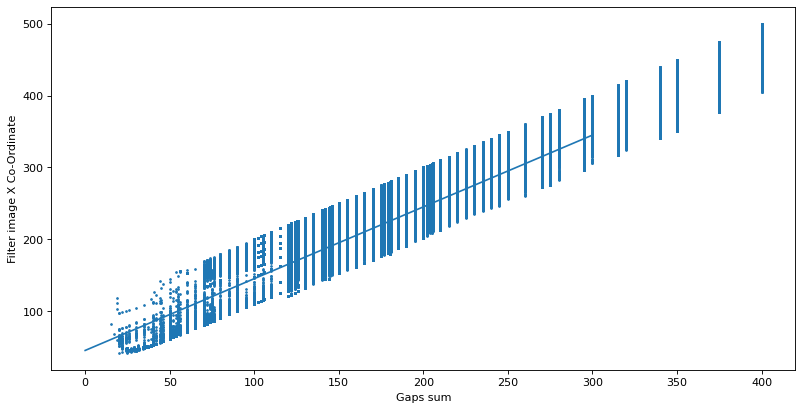

In [6]:
data = np.load("massLens.npy")
data = np.array(data)
#data in form [saved instance,param]
# params ordered inner image x, " y, outer image x, " y, focal length 1, 2, 3, gap1, gap2

x=np.linspace(0,300,1000)

plt.figure(figsize=(12, 6), dpi=80)
#plt.ylim((-10,10))
plt.scatter(data[:,7]+data[:,8],data[:,2],s=2)
plt.plot(x,x+45)
plt.ylabel("Filter image X Co-Ordinate")
plt.xlabel("Gaps sum")

We started with 344336 lens designs.
The list is now 268324 long
The list is now 12995 long
The list is now 10319 long


Text(0.5, 0, 'Gaps sum')

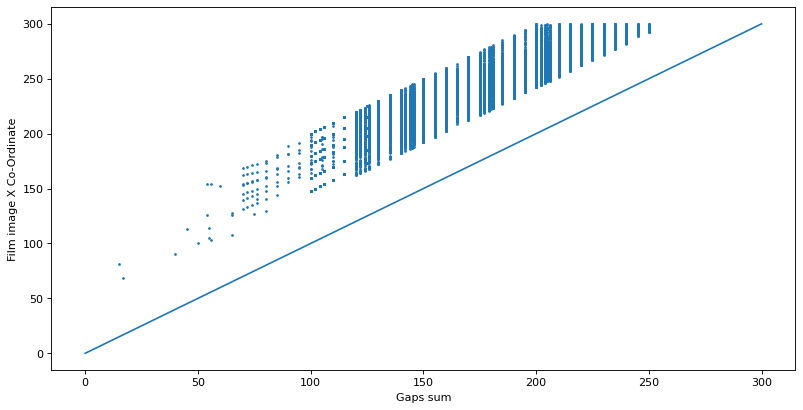

In [7]:
data = np.load("massLens.npy")

print("We started with " + str(len(data)) + " lens designs.")

#cull list for last image is at least 42mm from the last lens, so it'll actually hit the
data = [data[x,:] for x in list(range(0, len(data))) if data[x,2] > data[x,7]+data[x,8]+42]
data = np.array(data)
print("The list is now " + str(len(data)) + " long")
#Remove non-rectilinear
data = [data[x,:] for x in list(range(0, len(data))) if data[x,4] == data[x,5]]
data = np.array(data)
print("The list is now " + str(len(data)) + " long")
#make last image no more than 300mm, arbitrary restriction
data = [data[x,:] for x in list(range(0, len(data))) if data[x,2]<300]
data = np.array(data)
print("The list is now " + str(len(data)) + " long")

x=np.linspace(0,300,1000)

plt.figure(figsize=(12, 6), dpi=80)
#plt.ylim((-10,10))
plt.scatter(data[:,7]+data[:,8],data[:,2],s=2)
plt.plot(x,x)
plt.ylabel("Film image X Co-Ordinate")
plt.xlabel("Gaps sum")

In [8]:
#this calculates optical center of lenses. Yes, it should have been implemented above
#but it'll be faster to only check 12k lenses

images=[]
for i in list(range(0, len(data))):
    lens = opticalSystem(data[i,4], data[i,7], data[i,5], data[i,8], data[i,6])
    rays = np.array([(1,-2),(-1,2)])
    x = []
    y = []
    for j in [0,1]:
        tracedRay = lens.simRay(rays[j,0],rays[j,1])
        x.append(tracedRay[0])
        y.append(tracedRay[1])
                     
    intersect = intersection(x[0],y[0],x[1],y[1])
    if len(intersect) > 1:
        images.append(intersect[1,:])
    else:
        images.append(np.array([0,0]))
images = np.array(images)
data = np.append(data, images, axis=1)

print(data[0,:])

/tmp/ipykernel_97/267648438.py:22: RuntimeWarning: invalid value encountered in double_scalars
  dy1 = (y2-y1)/self.delX[1]


[2.40577444e+01 1.77635684e-15 1.39913461e+02 3.55271368e-15
 4.80000000e+01 4.80000000e+01 4.80000000e+01 0.00000000e+00
 7.00000000e+01 1.29962240e+02 1.42108547e-14]


Text(0.5, 0, 'Film Image')

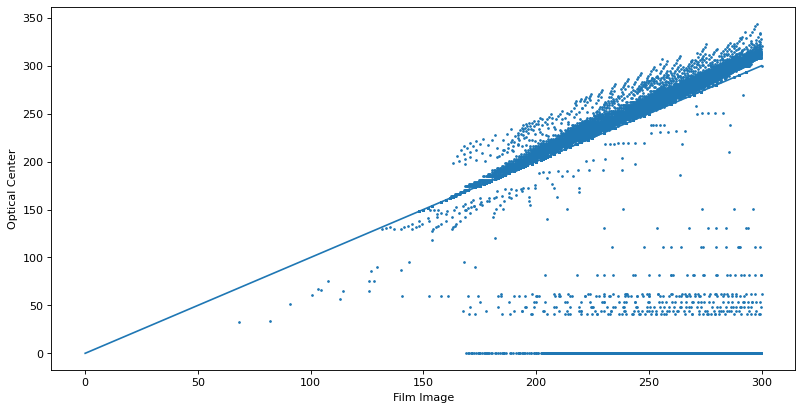

In [9]:
x=np.linspace(0,300,1000)

plt.figure(figsize=(12, 6), dpi=80)
#plt.ylim((-10,10))
plt.scatter(data[:,2],data[:,9], s=2)
plt.plot(x,x)
plt.ylabel("Optical Center")
plt.xlabel("Film Image")

The list is now 8522 long
The list is now 549 long


Text(0.5, 0, 'Film Image')

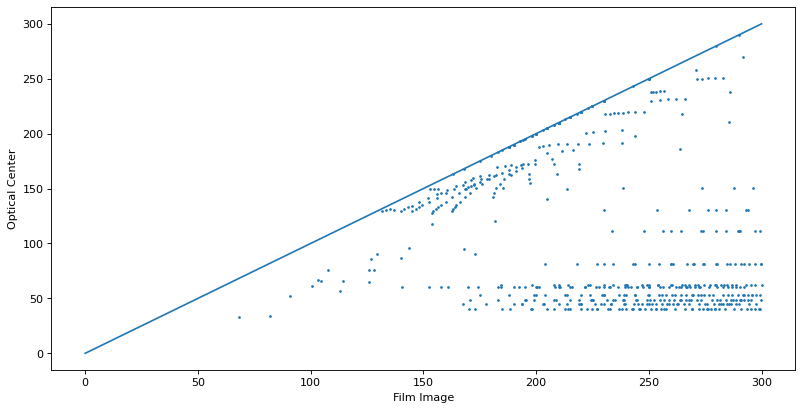

In [10]:
#Cull all center=0 lenses
data = [data[x,:] for x in list(range(0, len(data))) if data[x,9]!=0]
data = np.array(data)
print("The list is now " + str(len(data)) + " long")
#cull lenses with optical center past the lens
data = [data[x,:] for x in list(range(0, len(data))) if data[x,2] > data[x,9]]
data = np.array(data)
print("The list is now " + str(len(data)) + " long")

plt.figure(figsize=(12, 6), dpi=80)
#plt.ylim((-10,10))
plt.scatter(data[:,2],data[:,9], s=2)
plt.plot(x,x)
plt.ylabel("Optical Center")
plt.xlabel("Film Image")

Text(0.5, 0, 'Film Image/Lens Length')

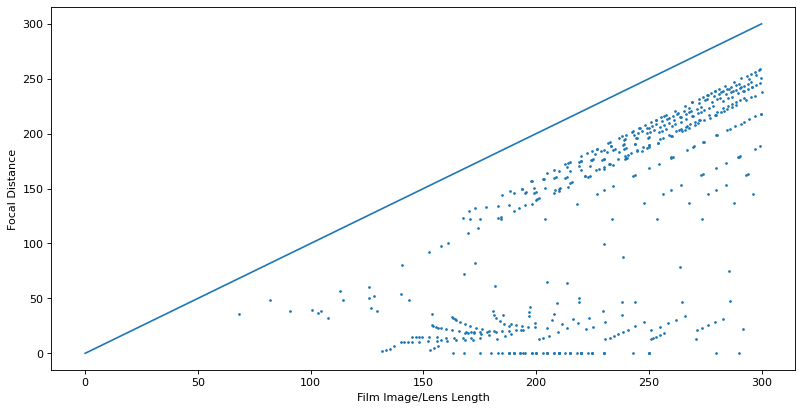

In [11]:
plt.figure(figsize=(12, 6), dpi=80)
#plt.ylim((-10,10))
plt.scatter(data[:,2],data[:,2] - data[:,9], s=2)
plt.plot(x,x)
plt.ylabel("Focal Distance")
plt.xlabel("Film Image/Lens Length")

The list is now 207 long


Text(0.5, 0, 'Film Image/Lens Length')

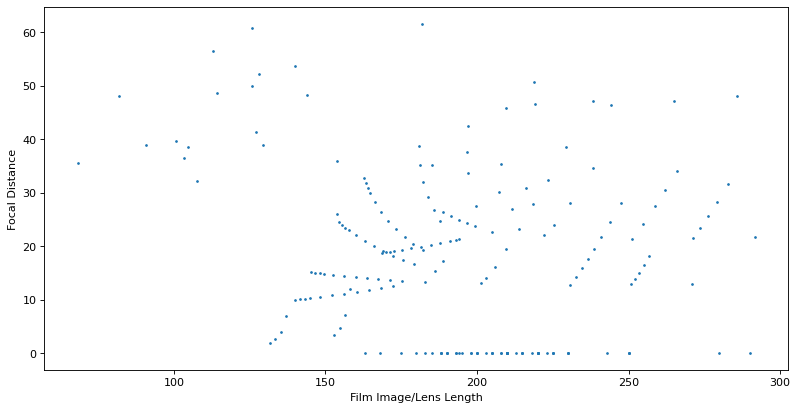

In [19]:
#cull lenses with Focal Distance larger than 65
data = [data[x,:] for x in list(range(0, len(data))) if data[x,2] - data[x,9] < 62.5]
data = np.array(data)
print("The list is now " + str(len(data)) + " long")

plt.figure(figsize=(12, 6), dpi=80)
#plt.ylim((-10,10))
plt.scatter(data[:,2],data[:,2] - data[:,9], s=2)
plt.ylabel("Focal Distance")
plt.xlabel("Film Image/Lens Length")

The list is now 16 long
The list is now 14 long


Text(0.5, 0, 'Film Image/Lens Length')

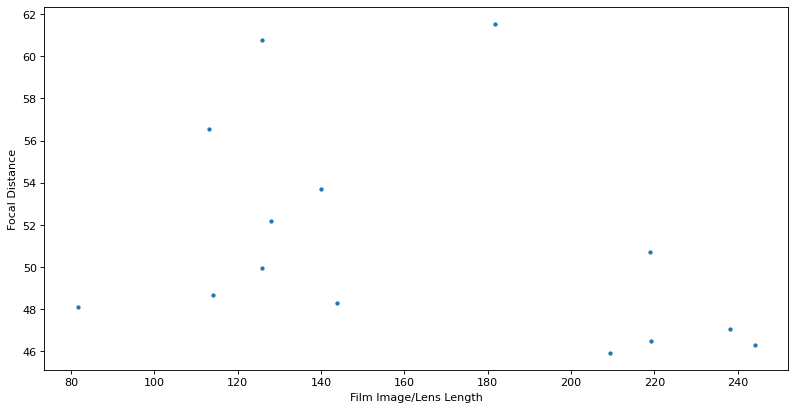

In [20]:
#cull lenses with Focal Distance smaller than 20
data = [data[x,:] for x in list(range(0, len(data))) if data[x,2] - data[x,9] > 45]
data = np.array(data)
print("The list is now " + str(len(data)) + " long")
#cull lenses with total length less than 160
data = [data[x,:] for x in list(range(0, len(data))) if data[x,2] < 250]
data = np.array(data)
print("The list is now " + str(len(data)) + " long")

plt.figure(figsize=(12, 6), dpi=80)
#plt.ylim((-10,10))
plt.scatter(data[:,2],data[:,2] - data[:,9], s=8)
plt.ylabel("Focal Distance")
plt.xlabel("Film Image/Lens Length")

/tmp/ipykernel_97/267648438.py:22: RuntimeWarning: invalid value encountered in double_scalars
  dy1 = (y2-y1)/self.delX[1]
/tmp/ipykernel_97/1892065852.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(12, 6), dpi=80)


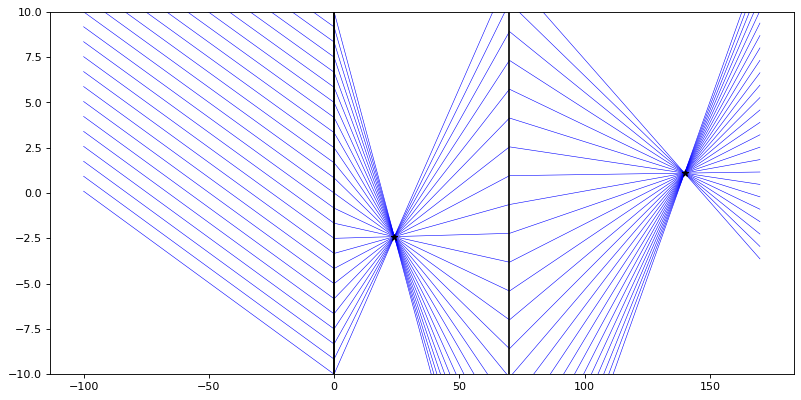

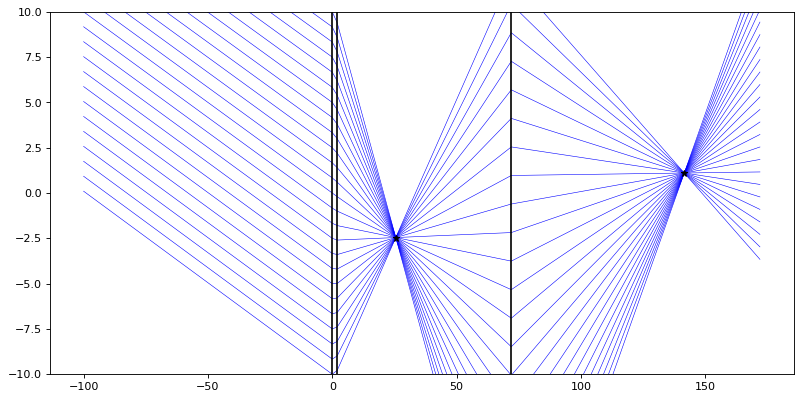

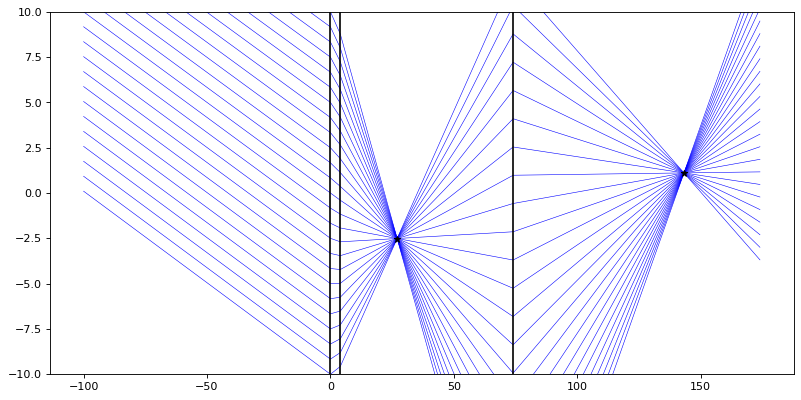

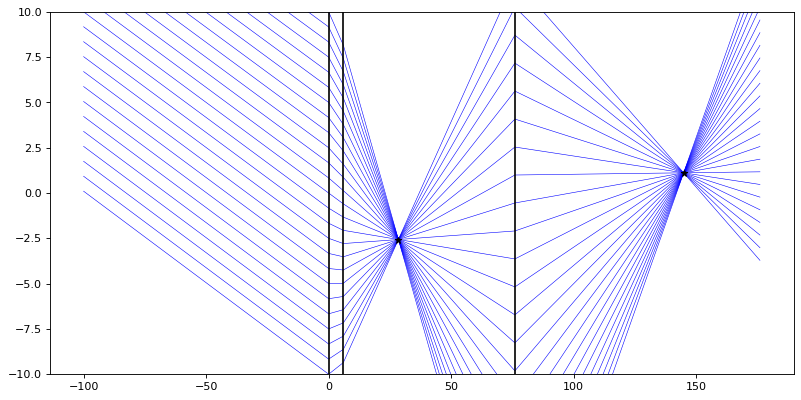

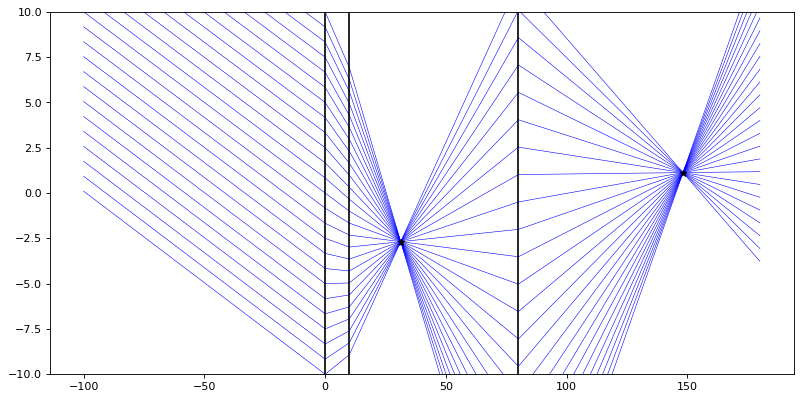

...

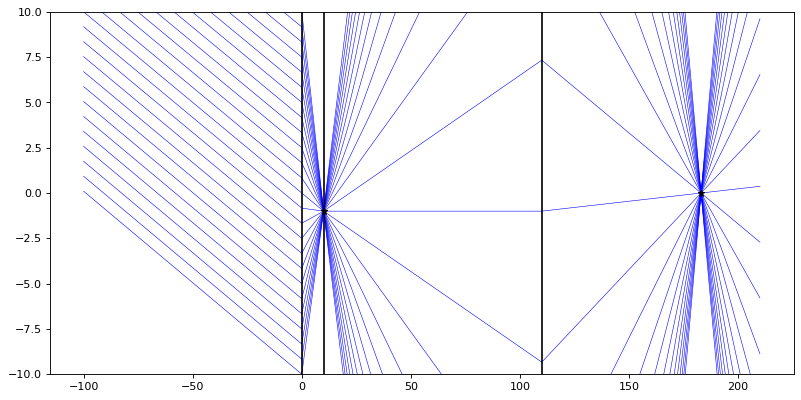

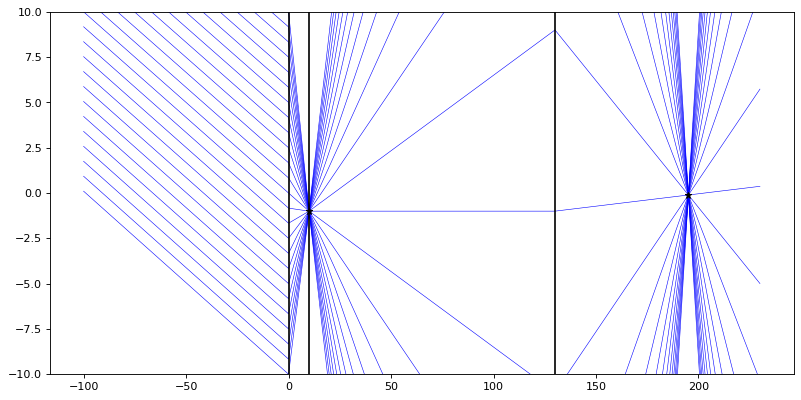

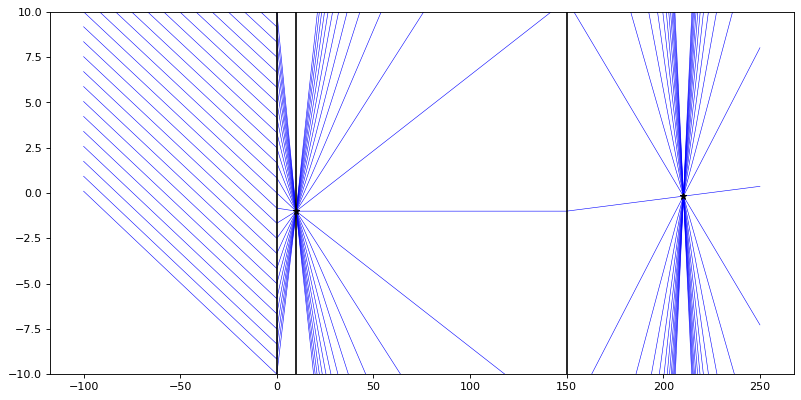

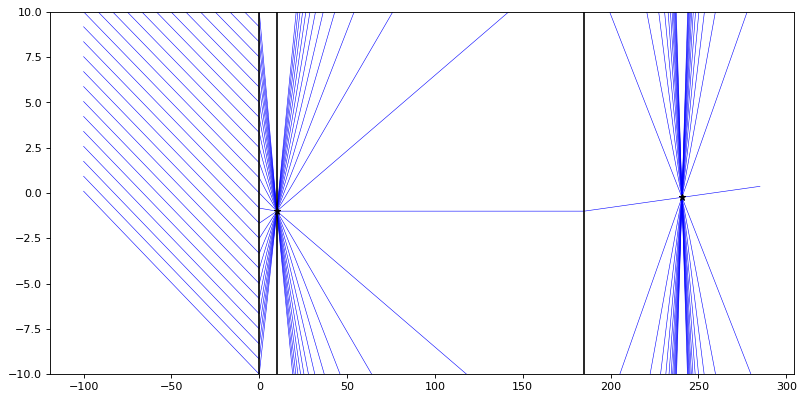

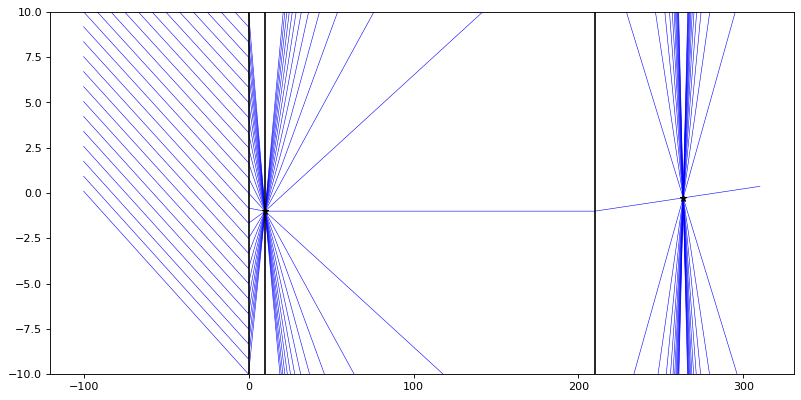

In [ ]:
#Finally, we graph our finalists!
# params ordered inner image x, " y, outer image x, " y, focal length 1, 2, 3, gap1, gap2

for i in np.arange(0,len(data),1):
    #EXAMPLE:intersection of two rays put through an optical system, as well as graphic output of said rays
    lens1Focal = data[i,4]
    lens2Focal = data[i,5]
    lens3Focal = data[i,6]
    gap1 = data[i,7]
    gap2 = data[i,8]
    lens1 = opticalSystem(lens1Focal, gap1, lens2Focal, gap2, lens3Focal)
    rays = imageRays(9999,1000,10,25)

    x = []
    y = []

    for i in range(0,len(rays[:,0]),1):
        tracedRay = lens1.simRay(rays[i,0],rays[i,1])
        x.append(tracedRay[0])
        y.append(tracedRay[1])

    plt.figure(figsize=(12, 6), dpi=80)
    plt.ylim((-10, 10))
    for i in range(0,len(rays[:,0]),1):
        plt.plot(x[i],y[i],'b',linewidth=0.5)


    plt.axvline(x = 0, color = 'k', label = 'axvline - full height')
    plt.axvline(x = gap1, color = 'k', label = 'axvline - full height')
    plt.axvline(x = gap2+gap1, color = 'k', label = 'axvline - full height')


    images = intersection(x[0],y[0],x[9],y[9])
    plt.plot(images[:,0],images[:,1],'k*')

In [22]:
win = data[9,:]
print(win)

[ 9.20699000e+01  0.00000000e+00  2.19086097e+02 -4.44089210e-16
  1.15000000e+02  1.15000000e+02  4.80000000e+01  5.00000000e+01
  7.00000000e+01  1.72588464e+02  1.42108547e-14]


In [23]:
focal1 = win[4]
focal2 = win[5]
focal3 = win[6]
Gap1s = np.linspace(40,60,100)
Gap2s = np.linspace(60,80,100)
fit = 0
tested = 0
print(Gap1s)
data = []
for gap1 in Gap1s:
    for gap2 in Gap2s:
        lens1 = opticalSystem(focal1, gap1, focal2, gap2, focal3)
        rays = imageRays(9999,1,10,25)
        x = []
        y = []

        for i in range(0,len(rays[:,0]),1):
            tracedRay = lens1.simRay(rays[i,0],rays[i,1])
            x.append(tracedRay[0])
            y.append(tracedRay[1])

        images = intersection(x[0],y[0],x[24],y[24])

        #save settup data if we get any images at all
        inner = []
        outer = []
        for image in images:
            if image[0]<(gap1+gap2) and image[0] > gap1:
                inner = image
            elif image[0] > (gap1+gap2):
                outer = image

        if inner != [] and outer != []:
            data.append([inner[0], inner[1], outer[0],outer[1], focal1, focal2, focal3, gap1, gap2])

            fit += 1
        tested += 1

print("I tested " + str(tested) + " lens setups and found " + str(fit) + " that satisfied image location requirments.")
data = np.array(data)


[40.         40.2020202  40.4040404  40.60606061 40.80808081 41.01010101
 41.21212121 41.41414141 41.61616162 41.81818182 42.02020202 42.22222222
 42.42424242 42.62626263 42.82828283 43.03030303 43.23232323 43.43434343
 43.63636364 43.83838384 44.04040404 44.24242424 44.44444444 44.64646465
 44.84848485 45.05050505 45.25252525 45.45454545 45.65656566 45.85858586
 46.06060606 46.26262626 46.46464646 46.66666667 46.86868687 47.07070707
 47.27272727 47.47474747 47.67676768 47.87878788 48.08080808 48.28282828
 48.48484848 48.68686869 48.88888889 49.09090909 49.29292929 49.49494949
 49.6969697  49.8989899  50.1010101  50.3030303  50.50505051 50.70707071
 50.90909091 51.11111111 51.31313131 51.51515152 51.71717172 51.91919192
 52.12121212 52.32323232 52.52525253 52.72727273 52.92929293 53.13131313
 53.33333333 53.53535354 53.73737374 53.93939394 54.14141414 54.34343434
 54.54545455 54.74747475 54.94949495 55.15151515 55.35353535 55.55555556
 55.75757576 55.95959596 56.16161616 56.36363636 56

/tmp/ipykernel_442/1866415057.py:33: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if inner != [] and outer != []:


I tested 10000 lens setups and found 5080 that satisfied image location requirments.


In [24]:
#find optical center
images = []
for i in list(range(0, len(data))):
    lens = opticalSystem(data[i,4], data[i,7], data[i,5], data[i,8], data[i,6])
    rays = np.array([(1,-2),(-1,2)])
    x = []
    y = []
    for j in [0,1]:
        tracedRay = lens.simRay(rays[j,0],rays[j,1])
        x.append(tracedRay[0])
        y.append(tracedRay[1])
                     
    intersect = intersection(x[0],y[0],x[1],y[1])
    if len(intersect) > 1:
        images.append(intersect[1,:])
    else:
        images.append(np.array([0,0]))
images = np.array(images)
data = np.append(data, images, axis=1)

<IPython.core.display.Javascript object>


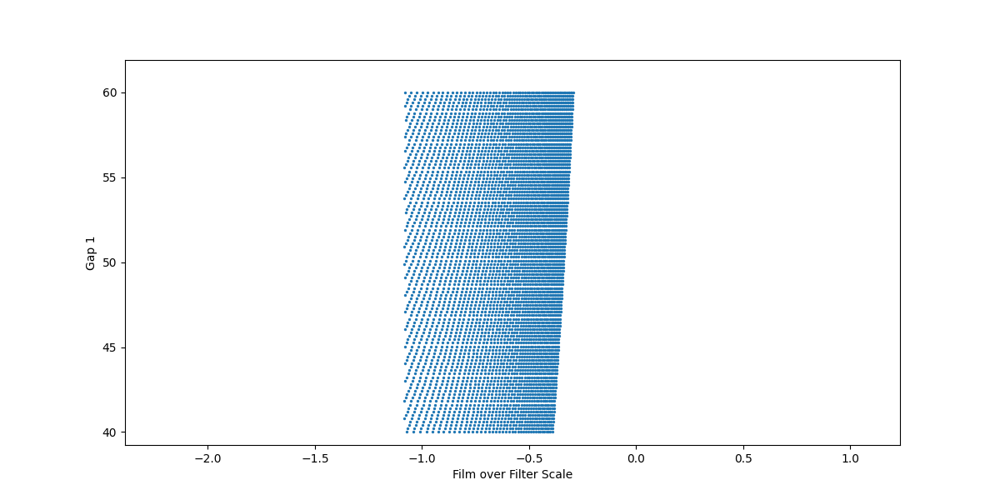

In [28]:
# params ordered inner image x, " y, outer image x, " y, focal length 1, 2, 3, gap1, gap2
%matplotlib notebook

plt.figure(figsize=(12, 6), dpi=80)
#plt.xlim((-1.2,-.2))
#plt.ylim((25,75))
plt.scatter(data[:,3]/data[:,1],data[:,7], s=2)
plt.plot(x,x)
plt.ylabel("Gap 1")
plt.xlabel("Film over Filter Scale")
plt.show()

In [ ]:
# params ordered inner image x, " y, outer image x, " y, focal length 1, 2, 3, gap1, gap2
%matplotlib notebook

plt.figure(figsize=(12, 6), dpi=80)
#plt.xlim((-1.2,-.2))
#plt.ylim((25,75))
plt.scatter(data[:,3]/data[:,1],data[:,2] - data[:,9], s=2)
plt.plot(x,x)
plt.ylabel("Focal Distance")
plt.xlabel("Film over Filter Scale")
plt.show()